In [ ]:
import warnings
warnings.simplefilter(action='ignore', category=FutureWarning)
import pandas as pd
pd.options.display.float_format = '{:.2f}'.format

In [1]:
import pandas as pd
import math
import seaborn as sns
from matplotlib import pyplot as plt
import re
import numpy as np
import geopandas as gpd
from shapely.geometry import Point # Point class
from shapely.geometry import shape
import io
from geopy.geocoders import Nominatim
geolocator = Nominatim(user_agent="geoapiExercises")
from geopy.geocoders import Nominatim
from time import sleep
from datetime import datetime

C:\Users\mmmiah\.conda\envs\geo_env\lib\site-packages\geopandas\_compat.py:112: UserWarning: The Shapely GEOS version (3.11.0-CAPI-1.17.0) is incompatible with the GEOS version PyGEOS was compiled with (3.10.3-CAPI-1.16.1). Conversions between both will be slow.
  warnings.warn(


In [40]:
# read the daily Volume
doh_weekday_factor=pd.read_csv('D:/Bike_ped Exposure Model Project/Processed Data/doh_weekday_factor.csv')
doh_weekend_factor=pd.read_csv('D:/Bike_ped Exposure Model Project/Processed Data/doh_weekend_factor.csv')

In [2]:
# read the indices
ind=pd.read_csv('D:/Bike_ped Exposure Model Project/Processed Data/Updated_indices.csv')
ind.head()

,Unnamed: 0.1,ID,year,Max_WWI,Average_WWI,Weekday_Aergage_AMI,Weekend_Aergage_AMI,Average AMI_wday_wend,Max_weekend_AMI,Max_weekday_AMI,...,stv_total,stv_com_total,stv_rec_total,stv_com_ratio,stv_rec_ratio,Field1,location_y,AADBT,no_of_mont,type
0,0,671,2016,2.232143,0.769600,0.703185,0.324525,2.166812,0.360694,0.930693,...,NaN,NaN,NaN,NaN,NaN,0.0,urban,53.547619,12.0,eco_permanent
1,1,671,2016,2.232143,0.769600,0.703185,0.324525,2.166812,0.360694,0.930693,...,NaN,NaN,NaN,NaN,NaN,1.0,urban,54.495040,12.0,eco_permanent
2,2,671,2016,2.232143,0.769600,0.703185,0.324525,2.166812,0.360694,0.930693,...,NaN,NaN,NaN,NaN,NaN,2.0,urban,52.724206,12.0,eco_permanent
3,3,671,2016,2.232143,0.769600,0.703185,0.324525,2.166812,0.360694,0.930693,...,NaN,NaN,NaN,NaN,NaN,3.0,urban,48.792659,12.0,eco_permanent
4,4,671,2017,2.893617,0.776723,0.743791,0.376689,1.974549,0.437975,1.020619,...,NaN,NaN,NaN,NaN,NaN,0.0,urban,53.547619,12.0,eco_permanent


In [3]:
ind.columns

Index(['Unnamed: 0.1', 'ID', 'year', 'Max_WWI', 'Average_WWI',
       'Weekday_Aergage_AMI', 'Weekend_Aergage_AMI', 'Average AMI_wday_wend',
       'Max_weekend_AMI', 'Max_weekday_AMI', 'Daily_Max_AMI', 'Daily_Max_PMI',
       'Weekday_Aergage_PMI', 'Weekend_Aergage_PMI', 'Average PMI_wday_wend',
       'Max_weekday_PMI', 'Max_weekend_PMI', 'max_daily_am/pm',
       'max_daily_am/pm_value', 'max_weekend_am/pm', 'max_weekend_am/pm_Value',
       'max_weekday_am/pm', 'max_weekday_am/pm_value', 'seasonal_factor',
       'latitude', 'longitude', 'location_x', 'road', 'city', 'county',
       'state', 'country', 'Unnamed: 0', 'edgeUID', 'osmId', 'dist',
       'stv_total', 'stv_com_total', 'stv_rec_total', 'stv_com_ratio',
       'stv_rec_ratio', 'Field1', 'location_y', 'AADBT', 'no_of_mont', 'type'],
      dtype='object')

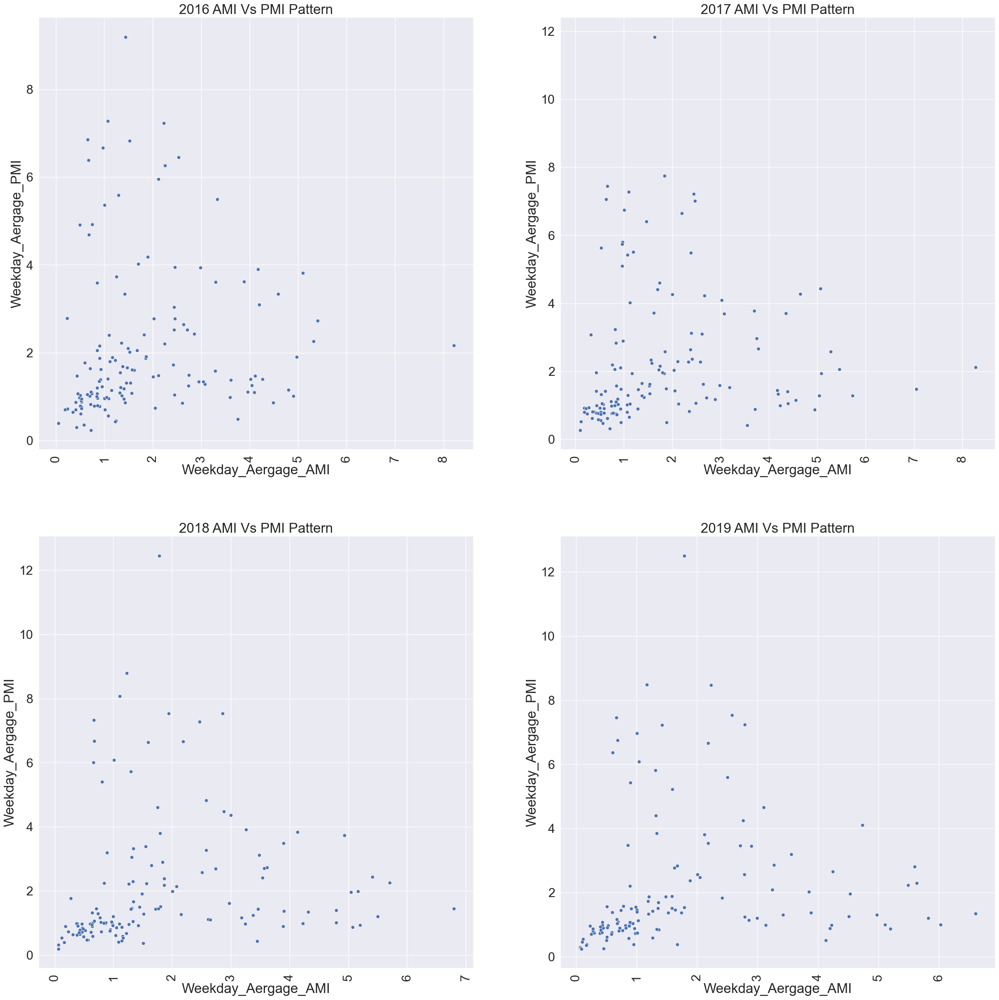

In [34]:
d16=ind.loc[ind['year']==2016]
d17=ind.loc[ind['year']==2017]
d18=ind.loc[ind['year']==2018]
d19=ind.loc[ind['year']==2019]

sns.set(rc={'figure.figsize':(30,30)})
sns.set(font_scale=2.0)
import seaborn as sns


fig, ax = plt.subplots(2,2)

ax1 = sns.scatterplot(x=d16['Weekday_Aergage_AMI'],y=d16['Weekday_Aergage_PMI'],
                   markers=True,marker="o", ax=ax[0,0]) 
plt.xticks(rotation = 'vertical')
ax2 = sns.scatterplot(x=d17['Weekday_Aergage_AMI'],y=d17['Weekday_Aergage_PMI'],
                   markers=True,marker="o", ax=ax[0,1]) 
plt.xticks(rotation = 'vertical')
ax3 = sns.scatterplot(x=d18['Weekday_Aergage_AMI'],y=d18['Weekday_Aergage_PMI'],
                   markers=True,marker="o",ax=ax[1,0])
plt.xticks(rotation = 'vertical')
ax4 = sns.scatterplot(x=d19['Weekday_Aergage_AMI'],y=d19['Weekday_Aergage_PMI'],
                   markers=True, marker="o",ax=ax[1,1]) 

ax1.title.set_text('2016 AMI Vs PMI Pattern')
ax2.title.set_text('2017 AMI Vs PMI Pattern')
ax3.title.set_text('2018 AMI Vs PMI Pattern')
ax4.title.set_text('2019 AMI Vs PMI Pattern')
plt.setp(ax1.xaxis.get_majorticklabels(), rotation=90)
plt.setp(ax2.xaxis.get_majorticklabels(), rotation=90)
plt.setp(ax3.xaxis.get_majorticklabels(), rotation=90)
plt.setp(ax4.xaxis.get_majorticklabels(), rotation=90)
ax1.set_ylabel('Weekday_Aergage_PMI' )
ax1.set_xlabel('Weekday_Aergage_AMI')
ax2.set_ylabel('Weekday_Aergage_PMI' )
ax2.set_xlabel('Weekday_Aergage_AMI')
ax3.set_ylabel('Weekday_Aergage_PMI' )
ax3.set_xlabel('Weekday_Aergage_AMI')
ax4.set_ylabel('Weekday_Aergage_PMI' )
ax4.set_xlabel('Weekday_Aergage_AMI')
plt.show()

In [27]:
# Separate Recreation Vs Commute Trip 
ind19=ind.loc[ind['year']==2019]
ind18=ind.loc[ind['year']==2018]
reccom=pd.concat([ind18,ind19],axis=0)
reccom.head()

,Unnamed: 0.1,ID,year,Max_WWI,Average_WWI,Weekday_Aergage_AMI,Weekend_Aergage_AMI,Average AMI_wday_wend,Max_weekend_AMI,Max_weekday_AMI,...,stv_total,stv_com_total,stv_rec_total,stv_com_ratio,stv_rec_ratio,Field1,location_y,AADBT,no_of_mont,type
8,8,671,2018,1.352564,0.710009,0.863646,0.291176,2.966061,0.295405,1.433566,...,4890.0,260.0,4630.0,0.053170,0.946830,NaN,NaN,NaN,NaN,NaN
9,9,671,2018,1.352564,0.710009,0.863646,0.291176,2.966061,0.295405,1.433566,...,4890.0,260.0,4630.0,0.053170,0.946830,NaN,NaN,NaN,NaN,NaN
10,10,671,2018,1.352564,0.710009,0.863646,0.291176,2.966061,0.295405,1.433566,...,4890.0,260.0,4630.0,0.053170,0.946830,NaN,NaN,NaN,NaN,NaN
11,11,671,2018,1.352564,0.710009,0.863646,0.291176,2.966061,0.295405,1.433566,...,4890.0,260.0,4630.0,0.053170,0.946830,NaN,NaN,NaN,NaN,NaN
27,27,2694,2018,3.443182,0.961077,0.677563,3.100174,0.218557,3.181049,1.027431,...,26680.0,320.0,26360.0,0.011994,0.988006,NaN,NaN,NaN,NaN,NaN


In [57]:
def comm_pattern(stv_com_ratio,stv_rec_ratio):
    if (stv_com_ratio>=0.60 and stv_rec_ratio<0.40):
        return 'commute'
    elif (stv_rec_ratio>=0.60 and stv_com_ratio<0.40):
        return 'recreational'
    else:
        return 'mixed'
    

In [58]:
reccom['travel pattern']=reccom.apply(lambda row: comm_pattern(row['stv_com_ratio'],row['stv_rec_ratio']),axis=1)
reccom.head()

,Unnamed: 0.1,ID,year,Max_WWI,Average_WWI,Weekday_Aergage_AMI,Weekend_Aergage_AMI,Average AMI_wday_wend,Max_weekend_AMI,Max_weekday_AMI,...,stv_com_total,stv_rec_total,stv_com_ratio,stv_rec_ratio,Field1,location_y,AADBT,no_of_mont,type,travel pattern
8,8,671,2018,1.352564,0.710009,0.863646,0.291176,2.966061,0.295405,1.433566,...,260.0,4630.0,0.053170,0.946830,NaN,NaN,NaN,NaN,NaN,recreational
9,9,671,2018,1.352564,0.710009,0.863646,0.291176,2.966061,0.295405,1.433566,...,260.0,4630.0,0.053170,0.946830,NaN,NaN,NaN,NaN,NaN,recreational
10,10,671,2018,1.352564,0.710009,0.863646,0.291176,2.966061,0.295405,1.433566,...,260.0,4630.0,0.053170,0.946830,NaN,NaN,NaN,NaN,NaN,recreational
11,11,671,2018,1.352564,0.710009,0.863646,0.291176,2.966061,0.295405,1.433566,...,260.0,4630.0,0.053170,0.946830,NaN,NaN,NaN,NaN,NaN,recreational
27,27,2694,2018,3.443182,0.961077,0.677563,3.100174,0.218557,3.181049,1.027431,...,320.0,26360.0,0.011994,0.988006,NaN,NaN,NaN,NaN,NaN,recreational


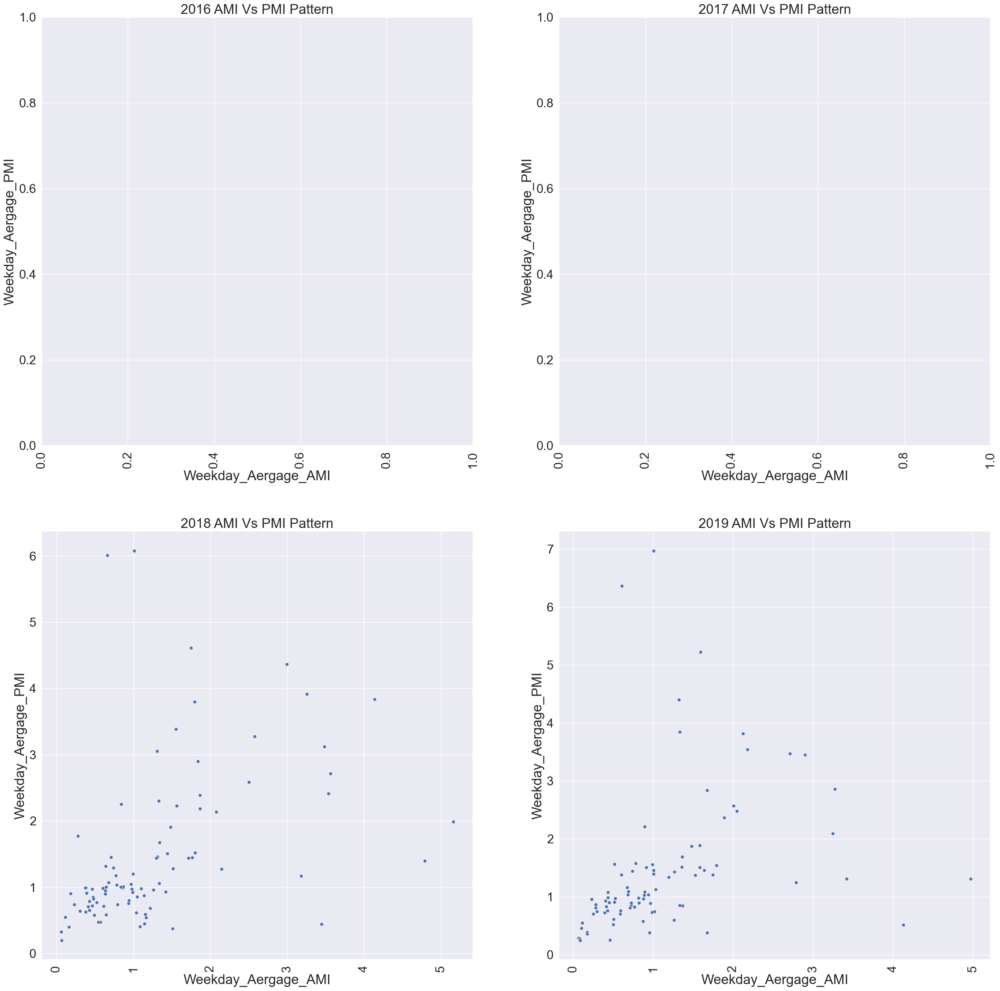

In [108]:
rec=reccom.loc[reccom['travel pattern']=='recreational']
d16=rec.loc[rec['year']==2016]
d17=rec.loc[rec['year']==2017]
d18=rec.loc[rec['year']==2018]
d19=rec.loc[rec['year']==2019]

sns.set(rc={'figure.figsize':(30,30)})
sns.set(font_scale=2.0)
import seaborn as sns


fig, ax = plt.subplots(2,2)

ax1 = sns.scatterplot(x=d16['Weekday_Aergage_AMI'],y=d16['Weekday_Aergage_PMI'],
                   markers=True,marker="o", ax=ax[0,0]) 
plt.xticks(rotation = 'vertical')
ax2 = sns.scatterplot(x=d17['Weekday_Aergage_AMI'],y=d17['Weekday_Aergage_PMI'],
                   markers=True,marker="o", ax=ax[0,1]) 
plt.xticks(rotation = 'vertical')
ax3 = sns.scatterplot(x=d18['Weekday_Aergage_AMI'],y=d18['Weekday_Aergage_PMI'],
                   markers=True,marker="o",ax=ax[1,0])
plt.xticks(rotation = 'vertical')
ax4 = sns.scatterplot(x=d19['Weekday_Aergage_AMI'],y=d19['Weekday_Aergage_PMI'],
                   markers=True, marker="o",ax=ax[1,1]) 

ax1.title.set_text('2016 AMI Vs PMI Pattern')
ax2.title.set_text('2017 AMI Vs PMI Pattern')
ax3.title.set_text('2018 AMI Vs PMI Pattern')
ax4.title.set_text('2019 AMI Vs PMI Pattern')
plt.setp(ax1.xaxis.get_majorticklabels(), rotation=90)
plt.setp(ax2.xaxis.get_majorticklabels(), rotation=90)
plt.setp(ax3.xaxis.get_majorticklabels(), rotation=90)
plt.setp(ax4.xaxis.get_majorticklabels(), rotation=90)
ax1.set_ylabel('Weekday_Aergage_PMI' )
ax1.set_xlabel('Weekday_Aergage_AMI')
ax2.set_ylabel('Weekday_Aergage_PMI' )
ax2.set_xlabel('Weekday_Aergage_AMI')
ax3.set_ylabel('Weekday_Aergage_PMI' )
ax3.set_xlabel('Weekday_Aergage_AMI')
ax4.set_ylabel('Weekday_Aergage_PMI' )
ax4.set_xlabel('Weekday_Aergage_AMI')
plt.show()

## Recreational,Commute and Mixed based on Strava Recreational and Commute Ratio

## for the weekday

In [129]:
# check the HOD factor by Recreation and commute type trip
weekday=pd.merge(doh_weekday_factor,reccom, left_on=['ID','year'], right_on=['ID','year'], how='inner')
weekday.head(15)

,Unnamed: 0_x,ID,year,starttime,Average_HOD_Factor,Unnamed: 0.1,Max_WWI,Average_WWI,Weekday_Aergage_AMI,Weekend_Aergage_AMI,...,stv_com_total,stv_rec_total,stv_com_ratio,stv_rec_ratio,Field1,location_y,AADBT,no_of_mont,type,travel pattern
0,48,671,2018,00:00:00,0.000799,8,1.352564,0.710009,0.863646,0.291176,...,260.0,4630.0,0.05317,0.94683,NaN,NaN,NaN,NaN,NaN,recreational
1,48,671,2018,00:00:00,0.000799,9,1.352564,0.710009,0.863646,0.291176,...,260.0,4630.0,0.05317,0.94683,NaN,NaN,NaN,NaN,NaN,recreational
2,48,671,2018,00:00:00,0.000799,10,1.352564,0.710009,0.863646,0.291176,...,260.0,4630.0,0.05317,0.94683,NaN,NaN,NaN,NaN,NaN,recreational
3,48,671,2018,00:00:00,0.000799,11,1.352564,0.710009,0.863646,0.291176,...,260.0,4630.0,0.05317,0.94683,NaN,NaN,NaN,NaN,NaN,recreational
4,49,671,2018,01:00:00,0.001090,8,1.352564,0.710009,0.863646,0.291176,...,260.0,4630.0,0.05317,0.94683,NaN,NaN,NaN,NaN,NaN,recreational
5,49,671,2018,01:00:00,0.001090,9,1.352564,0.710009,0.863646,0.291176,...,260.0,4630.0,0.05317,0.94683,NaN,NaN,NaN,NaN,NaN,recreational
6,49,671,2018,01:00:00,0.001090,10,1.352564,0.710009,0.863646,0.291176,...,260.0,4630.0,0.05317,0.94683,NaN,NaN,NaN,NaN,NaN,recreational
7,49,671,2018,01:00:00,0.001090,11,1.352564,0.710009,0.863646,0.291176,...,260.0,4630.0,0.05317,0.94683,NaN,NaN,NaN,NaN,NaN,recreational
8,50,671,2018,02:00:00,0.000073,8,1.352564,0.710009,0.863646,0.291176,...,260.0,4630.0,0.05317,0.94683,NaN,NaN,NaN,NaN,NaN,recreational
9,50,671,2018,02:00:00,0.000073,9,1.352564,0.710009,0.863646,0.291176,...,260.0,4630.0,0.05317,0.94683,NaN,NaN,NaN,NaN,NaN,recreational


In [130]:
def multiplot(rec1):
    d18=rec1.loc[rec1['year']==2018]
    d19=rec1.loc[rec1['year']==2019]
    import seaborn as sns

    sns.set(rc={'figure.figsize':(30,15)})
    sns.set(font_scale=2.0)
   


    fig, ax = plt.subplots(1,2)

    ax1 = sns.lineplot(x=d18['starttime'],y=d18['Average_HOD_Factor'],hue=d18['ID'],
                       markers=True,marker="o", dashes=False,sort=True,ax=ax[0])
    plt.xticks(rotation = 'vertical')
    ax1.tick_params(axis='x', rotation=90)
    ax2 = sns.lineplot(x=d19['starttime'],y=d19['Average_HOD_Factor'],hue=d19['ID'],
                       markers=True, marker="o", dashes=False,sort=True,ax=ax[1]) 
    plt.xticks(rotation = 'vertical')
    ax1.get_legend().remove()
    ax2.get_legend().remove()
    ax1.title.set_text('2018 Weekday Recreational HOD Factor')
    ax2.title.set_text('2019 Weekday Recreational HOD  Factor')
    plt.setp(ax3.xaxis.get_majorticklabels(), rotation=90)
    plt.setp(ax4.xaxis.get_majorticklabels(), rotation=90)
    ax1.set_ylabel('Weekday HOD Factor' )
    ax1.set_xlabel('Time')
    ax2.set_ylabel('Weekday HOD Factor' )
    ax2.set_xlabel('Time')
    plt.show()


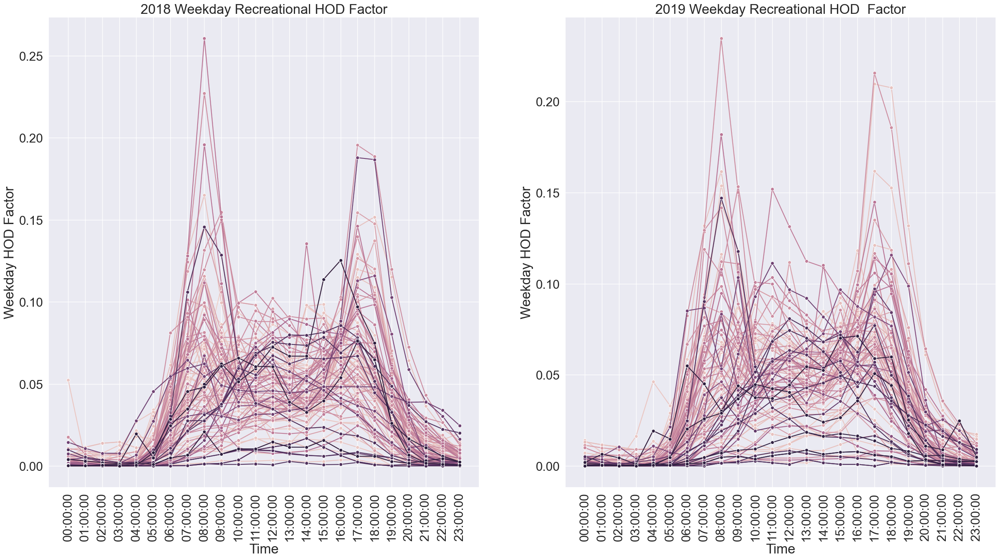

In [131]:
rec1=weekday.loc[weekday['travel pattern']=='recreational']
multiplot(rec1)

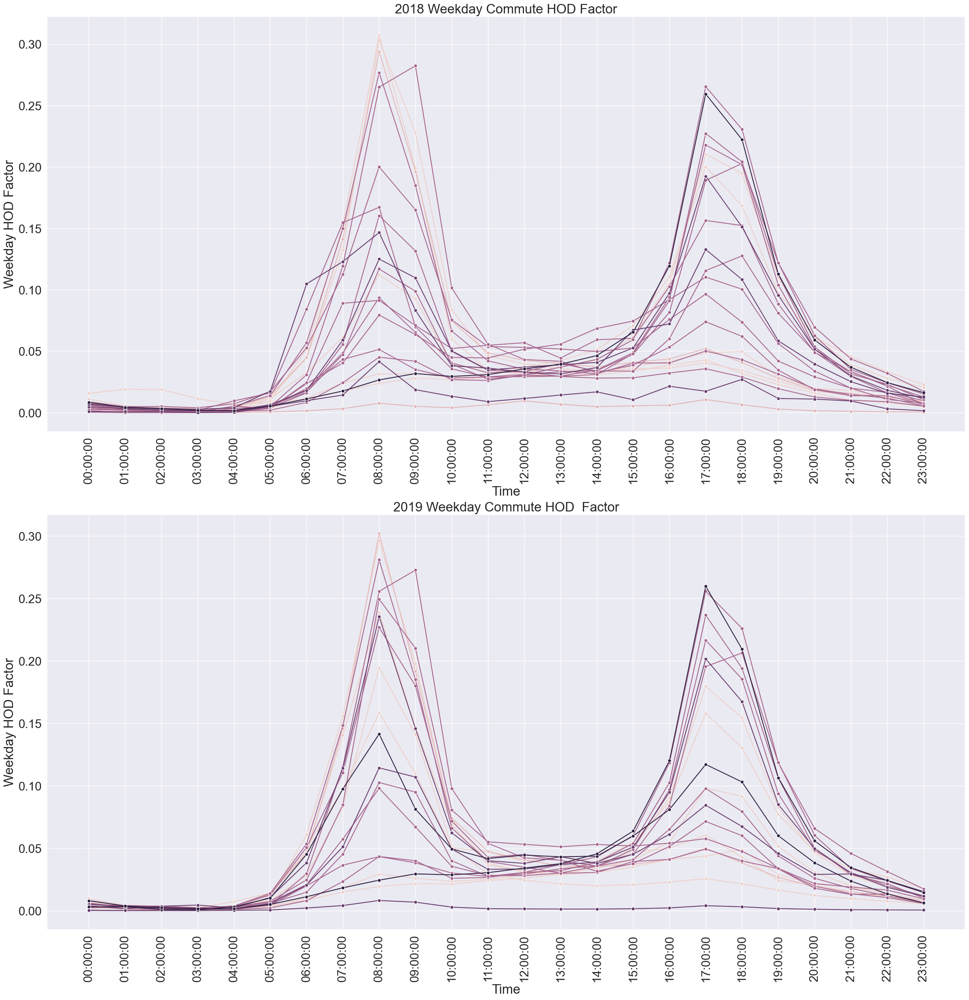

In [132]:
rec1=weekday.loc[reco_hv['travel pattern']=='commute']
d18=rec1.loc[rec1['year']==2018]
d19=rec1.loc[rec1['year']==2019]

sns.set(rc={'figure.figsize':(30,30)})
sns.set(font_scale=2.0)
import seaborn as sns


fig, ax = plt.subplots(2,1)
plt.xticks(rotation = 'vertical')
ax1 = sns.lineplot(x=d18['starttime'],y=d18['Average_HOD_Factor'],hue=d18['ID'],
                   markers=True,marker="o", dashes=False,sort=True,ax=ax[0])
plt.xticks(rotation = 'vertical')
ax1.tick_params(axis='x', rotation=90)
ax2 = sns.lineplot(x=d19['starttime'],y=d19['Average_HOD_Factor'],hue=d19['ID'],
                   markers=True, marker="o", dashes=False,sort=True,ax=ax[1]) 
plt.xticks(rotation = 'vertical')
ax1.get_legend().remove()
ax2.get_legend().remove()
ax1.title.set_text('2018 Weekday Commute HOD Factor')
ax2.title.set_text('2019 Weekday Commute HOD  Factor')
plt.setp(ax3.xaxis.get_majorticklabels(), rotation=90)
plt.setp(ax4.xaxis.get_majorticklabels(), rotation=90)
ax1.set_ylabel('Weekday HOD Factor' )
ax1.set_xlabel('Time')
ax2.set_ylabel('Weekday HOD Factor' )
ax2.set_xlabel('Time')
plt.show()

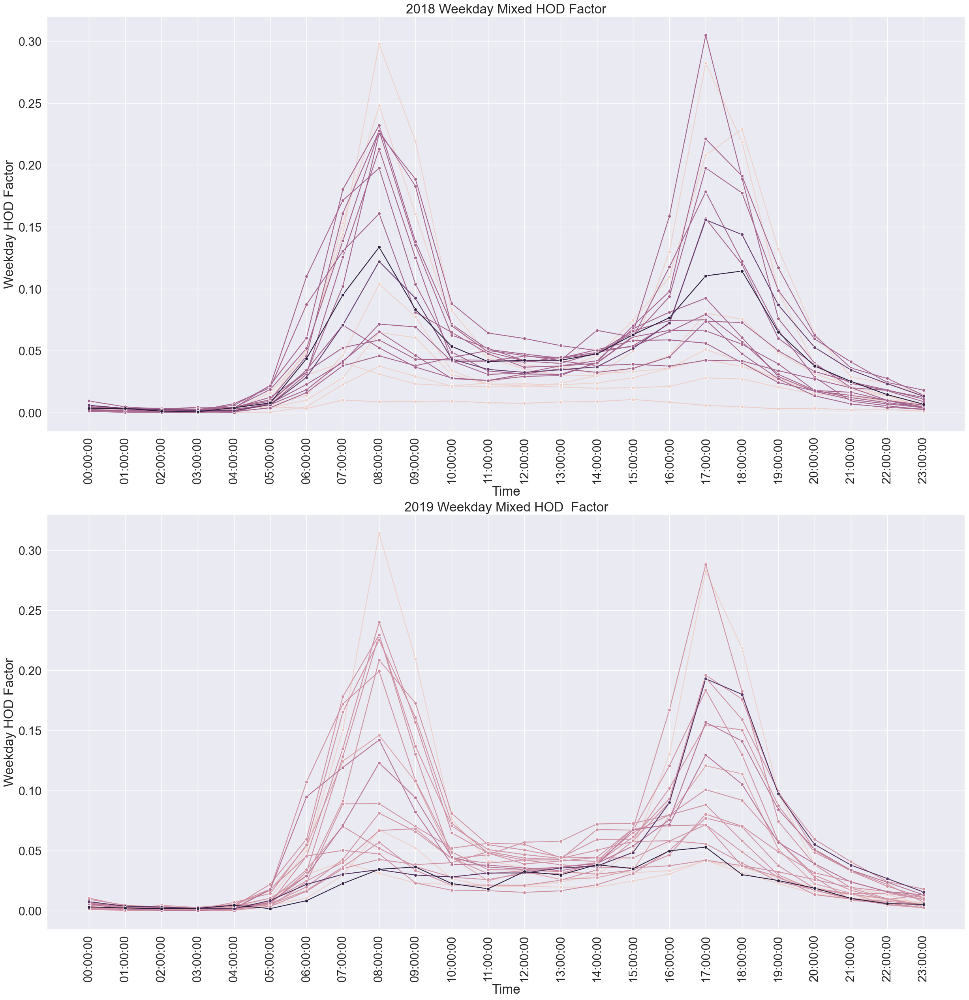

In [133]:
rec1=weekday.loc[reco_hv['travel pattern']=='mixed']
d18=rec1.loc[rec1['year']==2018]
d19=rec1.loc[rec1['year']==2019]

sns.set(rc={'figure.figsize':(30,30)})
sns.set(font_scale=2.0)
import seaborn as sns


fig, ax = plt.subplots(2,1)

ax1 = sns.lineplot(x=d18['starttime'],y=d18['Average_HOD_Factor'],hue=d18['ID'],
                   markers=True,marker="o", dashes=False,sort=True,ax=ax[0])
plt.xticks(rotation = 'vertical')
ax1.tick_params(axis='x', rotation=90)
ax2 = sns.lineplot(x=d19['starttime'],y=d19['Average_HOD_Factor'],hue=d19['ID'],
                   markers=True, marker="o", dashes=False,sort=True,ax=ax[1]) 
plt.xticks(rotation = 'vertical')
ax1.get_legend().remove()
ax2.get_legend().remove()
ax1.title.set_text('2018 Weekday Mixed HOD Factor')
ax2.title.set_text('2019 Weekday Mixed HOD  Factor')
plt.setp(ax3.xaxis.get_majorticklabels(), rotation=90)
plt.setp(ax4.xaxis.get_majorticklabels(), rotation=90)
ax1.set_ylabel('Weekday HOD Factor' )
ax1.set_xlabel('Time')
ax2.set_ylabel('Weekday HOD Factor' )
ax2.set_xlabel('Time')
plt.show()

# check for the weekend pattern

In [125]:
# check the HOD factor by Recreation and commute type trip
weekend=pd.merge(doh_weekend_factor,reccom, left_on=['ID','year'], right_on=['ID','year'], how='inner')
weekend.head(15)

,Unnamed: 0_x,ID,year,starttime,Average_HOD_Factor,Unnamed: 0.1,Max_WWI,Average_WWI,Weekday_Aergage_AMI,Weekend_Aergage_AMI,...,stv_com_total,stv_rec_total,stv_com_ratio,stv_rec_ratio,Field1,location_y,AADBT,no_of_mont,type,travel pattern
0,48,671,2018,00:00:00,0.000729,8,1.352564,0.710009,0.863646,0.291176,...,260.0,4630.0,0.05317,0.94683,NaN,NaN,NaN,NaN,NaN,recreational
1,48,671,2018,00:00:00,0.000729,9,1.352564,0.710009,0.863646,0.291176,...,260.0,4630.0,0.05317,0.94683,NaN,NaN,NaN,NaN,NaN,recreational
2,48,671,2018,00:00:00,0.000729,10,1.352564,0.710009,0.863646,0.291176,...,260.0,4630.0,0.05317,0.94683,NaN,NaN,NaN,NaN,NaN,recreational
3,48,671,2018,00:00:00,0.000729,11,1.352564,0.710009,0.863646,0.291176,...,260.0,4630.0,0.05317,0.94683,NaN,NaN,NaN,NaN,NaN,recreational
4,49,671,2018,01:00:00,0.000729,8,1.352564,0.710009,0.863646,0.291176,...,260.0,4630.0,0.05317,0.94683,NaN,NaN,NaN,NaN,NaN,recreational
5,49,671,2018,01:00:00,0.000729,9,1.352564,0.710009,0.863646,0.291176,...,260.0,4630.0,0.05317,0.94683,NaN,NaN,NaN,NaN,NaN,recreational
6,49,671,2018,01:00:00,0.000729,10,1.352564,0.710009,0.863646,0.291176,...,260.0,4630.0,0.05317,0.94683,NaN,NaN,NaN,NaN,NaN,recreational
7,49,671,2018,01:00:00,0.000729,11,1.352564,0.710009,0.863646,0.291176,...,260.0,4630.0,0.05317,0.94683,NaN,NaN,NaN,NaN,NaN,recreational
8,50,671,2018,02:00:00,0.000365,8,1.352564,0.710009,0.863646,0.291176,...,260.0,4630.0,0.05317,0.94683,NaN,NaN,NaN,NaN,NaN,recreational
9,50,671,2018,02:00:00,0.000365,9,1.352564,0.710009,0.863646,0.291176,...,260.0,4630.0,0.05317,0.94683,NaN,NaN,NaN,NaN,NaN,recreational


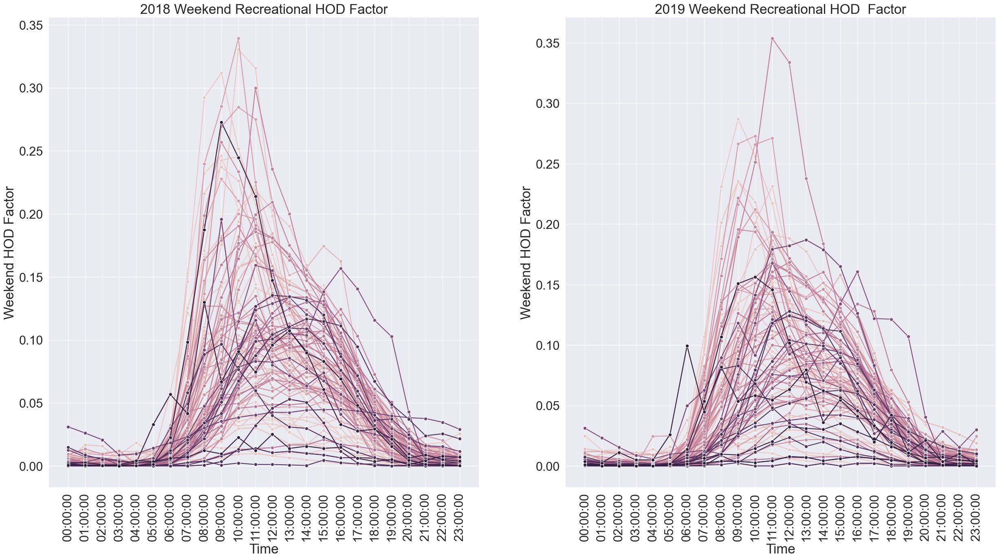

In [126]:
com1=weekend.loc[com_hv['travel pattern']=='recreational']
d18=com1.loc[com1['year']==2018]
d19=com1.loc[com1['year']==2019]
import seaborn as sns

sns.set(rc={'figure.figsize':(30,15)})
sns.set(font_scale=2.0)



fig, ax = plt.subplots(1,2)

ax1 = sns.lineplot(x=d18['starttime'],y=d18['Average_HOD_Factor'],hue=d18['ID'],
                   markers=True,marker="o", dashes=False,sort=True,ax=ax[0])
plt.xticks(rotation = 'vertical')
ax1.tick_params(axis='x', rotation=90)
ax2 = sns.lineplot(x=d19['starttime'],y=d19['Average_HOD_Factor'],hue=d19['ID'],
                   markers=True, marker="o", dashes=False,sort=True,ax=ax[1]) 
plt.xticks(rotation = 'vertical')
ax1.get_legend().remove()
ax2.get_legend().remove()
ax1.title.set_text('2018 Weekend Recreational HOD Factor')
ax2.title.set_text('2019 Weekend Recreational HOD  Factor')
plt.setp(ax3.xaxis.get_majorticklabels(), rotation=90)
plt.setp(ax4.xaxis.get_majorticklabels(), rotation=90)
ax1.set_ylabel('Weekend HOD Factor' )
ax1.set_xlabel('Time')
ax2.set_ylabel('Weekend HOD Factor' )
ax2.set_xlabel('Time')
plt.show()


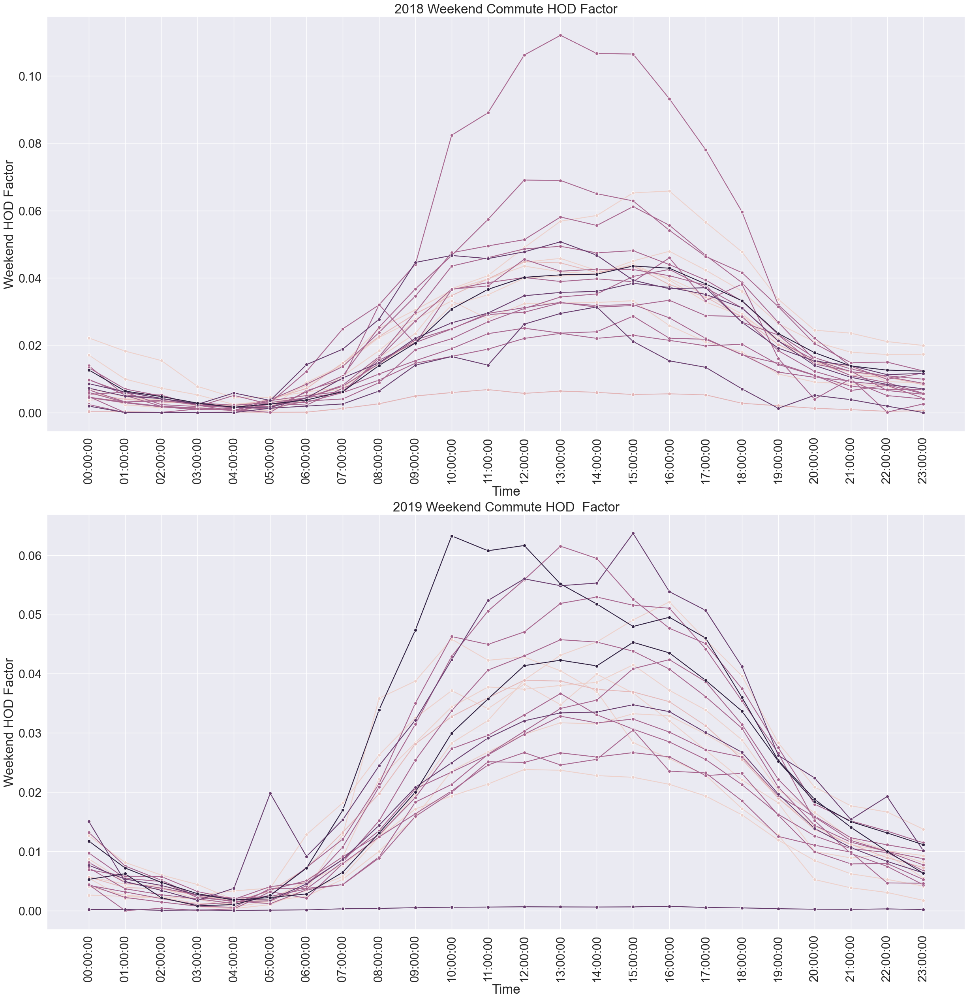

In [127]:
com1=weekend.loc[com_hv['travel pattern']=='commute']
d18=com1.loc[com1['year']==2018]
d19=com1.loc[com1['year']==2019]

sns.set(rc={'figure.figsize':(30,30)})
sns.set(font_scale=2.0)
import seaborn as sns


fig, ax = plt.subplots(2,1)
plt.xticks(rotation = 'vertical')
ax1 = sns.lineplot(x=d18['starttime'],y=d18['Average_HOD_Factor'],hue=d18['ID'],
                   markers=True,marker="o", dashes=False,sort=True,ax=ax[0])
plt.xticks(rotation = 'vertical')
ax1.tick_params(axis='x', rotation=90)
ax2 = sns.lineplot(x=d19['starttime'],y=d19['Average_HOD_Factor'],hue=d19['ID'],
                   markers=True, marker="o", dashes=False,sort=True,ax=ax[1]) 
plt.xticks(rotation = 'vertical')
ax1.get_legend().remove()
ax2.get_legend().remove()
ax1.title.set_text('2018 Weekend Commute HOD Factor')
ax2.title.set_text('2019 Weekend Commute HOD  Factor')
plt.setp(ax3.xaxis.get_majorticklabels(), rotation=90)
plt.setp(ax4.xaxis.get_majorticklabels(), rotation=90)
ax1.set_ylabel('Weekend HOD Factor' )
ax1.set_xlabel('Time')
ax2.set_ylabel('Weekend HOD Factor' )
ax2.set_xlabel('Time')
plt.show()

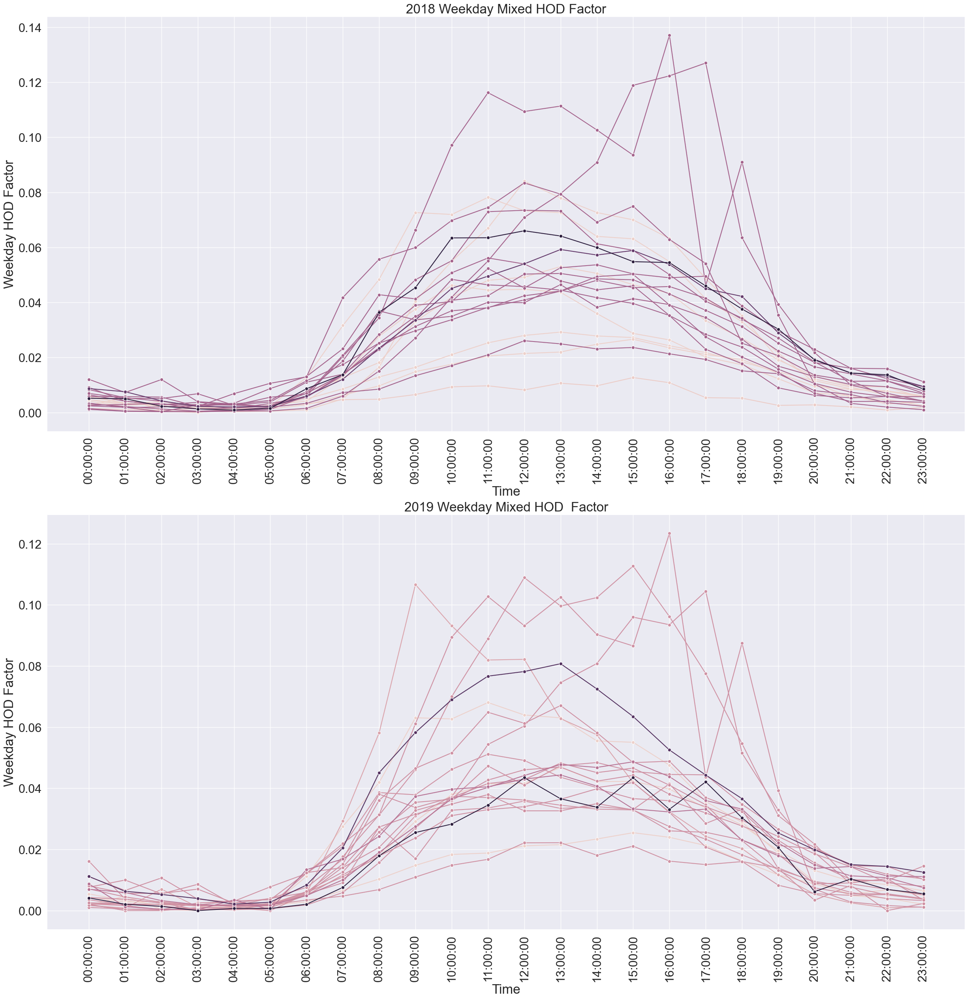

In [128]:
com1=weekend.loc[com_hv['travel pattern']=='mixed']
d18=com1.loc[com1['year']==2018]
d19=com1.loc[com1['year']==2019]

sns.set(rc={'figure.figsize':(30,30)})
sns.set(font_scale=2.0)
import seaborn as sns


fig, ax = plt.subplots(2,1)

ax1 = sns.lineplot(x=d18['starttime'],y=d18['Average_HOD_Factor'],hue=d18['ID'],
                   markers=True,marker="o", dashes=False,sort=True,ax=ax[0])
plt.xticks(rotation = 'vertical')
ax1.tick_params(axis='x', rotation=90)
ax2 = sns.lineplot(x=d19['starttime'],y=d19['Average_HOD_Factor'],hue=d19['ID'],
                   markers=True, marker="o", dashes=False,sort=True,ax=ax[1]) 
plt.xticks(rotation = 'vertical')
ax1.get_legend().remove()
ax2.get_legend().remove()
ax1.title.set_text('2018 Weekday Mixed HOD Factor')
ax2.title.set_text('2019 Weekday Mixed HOD  Factor')
plt.setp(ax3.xaxis.get_majorticklabels(), rotation=90)
plt.setp(ax4.xaxis.get_majorticklabels(), rotation=90)
ax1.set_ylabel('Weekday HOD Factor' )
ax1.set_xlabel('Time')
ax2.set_ylabel('Weekday HOD Factor' )
ax2.set_xlabel('Time')
plt.show()

In [134]:
weekday.columns

Index(['Unnamed: 0_x', 'ID', 'year', 'starttime', 'Average_HOD_Factor',
       'Unnamed: 0.1', 'Max_WWI', 'Average_WWI', 'Weekday_Aergage_AMI',
       'Weekend_Aergage_AMI', 'Average AMI_wday_wend', 'Max_weekend_AMI',
       'Max_weekday_AMI', 'Daily_Max_AMI', 'Daily_Max_PMI',
       'Weekday_Aergage_PMI', 'Weekend_Aergage_PMI', 'Average PMI_wday_wend',
       'Max_weekday_PMI', 'Max_weekend_PMI', 'max_daily_am/pm',
       'max_daily_am/pm_value', 'max_weekend_am/pm', 'max_weekend_am/pm_Value',
       'max_weekday_am/pm', 'max_weekday_am/pm_value', 'seasonal_factor',
       'latitude', 'longitude', 'location_x', 'road', 'city', 'county',
       'state', 'country', 'Unnamed: 0_y', 'edgeUID', 'osmId', 'dist',
       'stv_total', 'stv_com_total', 'stv_rec_total', 'stv_com_ratio',
       'stv_rec_ratio', 'Field1', 'location_y', 'AADBT', 'no_of_mont', 'type',
       'travel pattern'],
      dtype='object')

# Check the Seasonality Pattern for Weekday

In [141]:
# join indices and weekday HOD factor together
seasional_weekday=pd.merge(doh_weekday_factor,ind, left_on=['ID','year'], right_on=['ID','year'], how='inner')
seasional_weekday.shape

(51816, 49)

In [189]:
#define Function for plot
def multiplot4(seasional_weekday):
    d16=seasional_weekday.loc[seasional_weekday['year']==2016]
    d17=seasional_weekday.loc[seasional_weekday['year']==2017]
    d18=seasional_weekday.loc[seasional_weekday['year']==2018]
    d19=seasional_weekday.loc[seasional_weekday['year']==2019]
    import seaborn as sns

    sns.set(rc={'figure.figsize':(30,30)})
    sns.set(font_scale=2.0)
   


    fig, ax = plt.subplots(2,2)

    ax1 = sns.lineplot(x=d16['starttime'],y=d16['Average_HOD_Factor'],hue=d16['ID'],
                       markers=True,marker="o", dashes=False,sort=True,ax=ax[0,0]) 
    plt.xticks(rotation = 'vertical')
    ax2 = sns.lineplot(x=d17['starttime'],y=d17['Average_HOD_Factor'],hue=d17['ID'],
                       markers=True,marker="o", dashes=False,sort=True,ax=ax[0,1]) 
    plt.xticks(rotation = 'vertical')
    ax3 = sns.lineplot(x=d18['starttime'],y=d18['Average_HOD_Factor'],hue=d18['ID'],
                       markers=True,marker="o", dashes=False,sort=True,ax=ax[1,0])
    plt.xticks(rotation = 'vertical')
    ax4 = sns.lineplot(x=d19['starttime'],y=d19['Average_HOD_Factor'],hue=d19['ID'],
                       markers=True, marker="o", dashes=False,sort=True,ax=ax[1,1]) 
    plt.xticks(rotation = 'vertical')
    ax1.get_legend().remove()
    ax2.get_legend().remove()
    ax3.get_legend().remove()
    ax4.get_legend().remove()
    ax1.title.set_text('2016 Weekday HOD Factor')
    ax2.title.set_text('2017 Weekday HOD  Factor')
    ax3.title.set_text('2018 Weekday HOD Factor')
    ax4.title.set_text('2019 Weekday HOD  Factor')
    plt.setp(ax1.xaxis.get_majorticklabels(), rotation=90)
    plt.setp(ax2.xaxis.get_majorticklabels(), rotation=90)
    plt.setp(ax3.xaxis.get_majorticklabels(), rotation=90)
    plt.setp(ax4.xaxis.get_majorticklabels(), rotation=90)
    ax1.set_ylabel('Weekday HOD Factor' )
    ax1.set_xlabel('Time')
    ax2.set_ylabel('Weekday HOD Factor' )
    ax2.set_xlabel('Time')
    ax3.set_ylabel('Weekday HOD Factor' )
    ax3.set_xlabel('Time')
    ax4.set_ylabel('Weekday HOD Factor' )
    ax4.set_xlabel('Time')
    plt.show()


In [190]:
#classify the seasonal pattern
high_s1=seasional_weekday.loc[seasional_weekday['seasonal_factor']>2.0]
mid_s1 = seasional_weekday[(seasional_weekday.seasonal_factor>1) & (seasional_weekday.seasonal_factor<=1.5)]
mid_s2 = seasional_weekday[(seasional_weekday.seasonal_factor>1.5) & (seasional_weekday.seasonal_factor<=2)]
low_s1 = seasional_weekday.loc[seasional_weekday['seasonal_factor']<=1.0]
high_s1.shape,mid_s1.shape,low_s1.shape

((4728, 49), (29376, 49), (2064, 49))

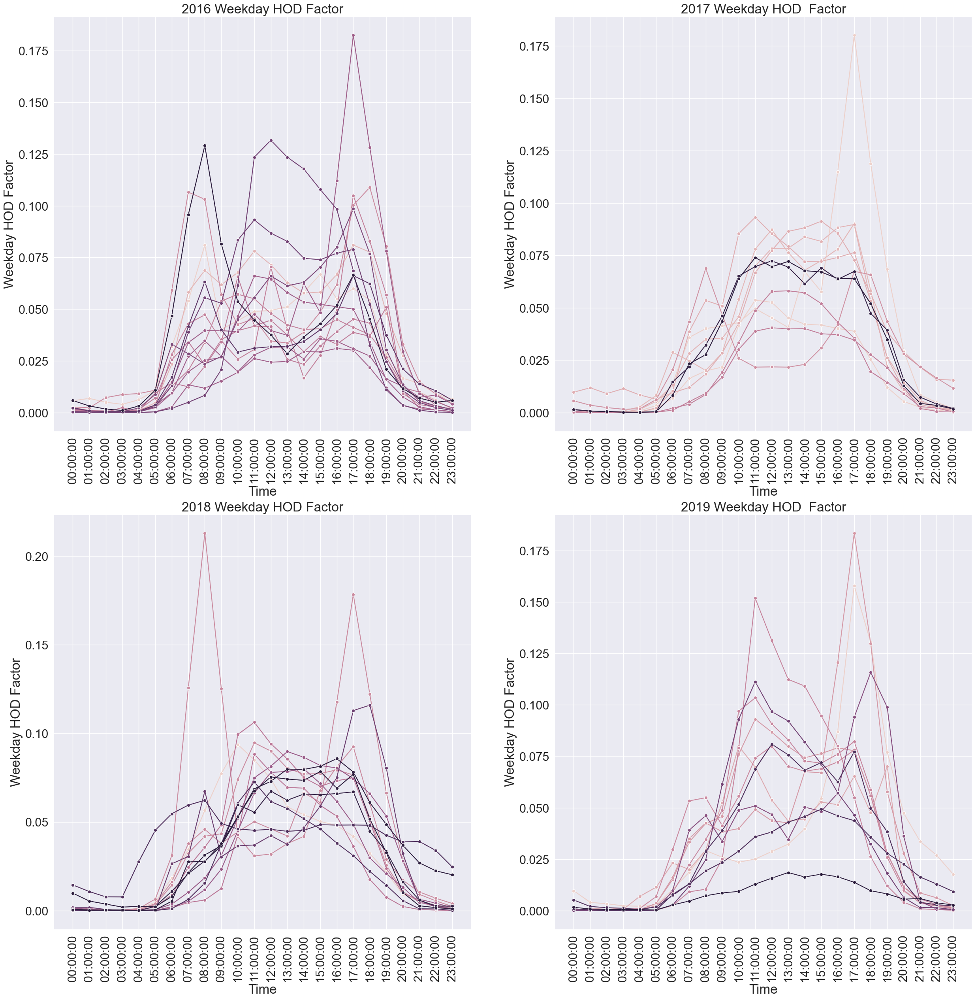

In [191]:
multiplot4(high_s1)

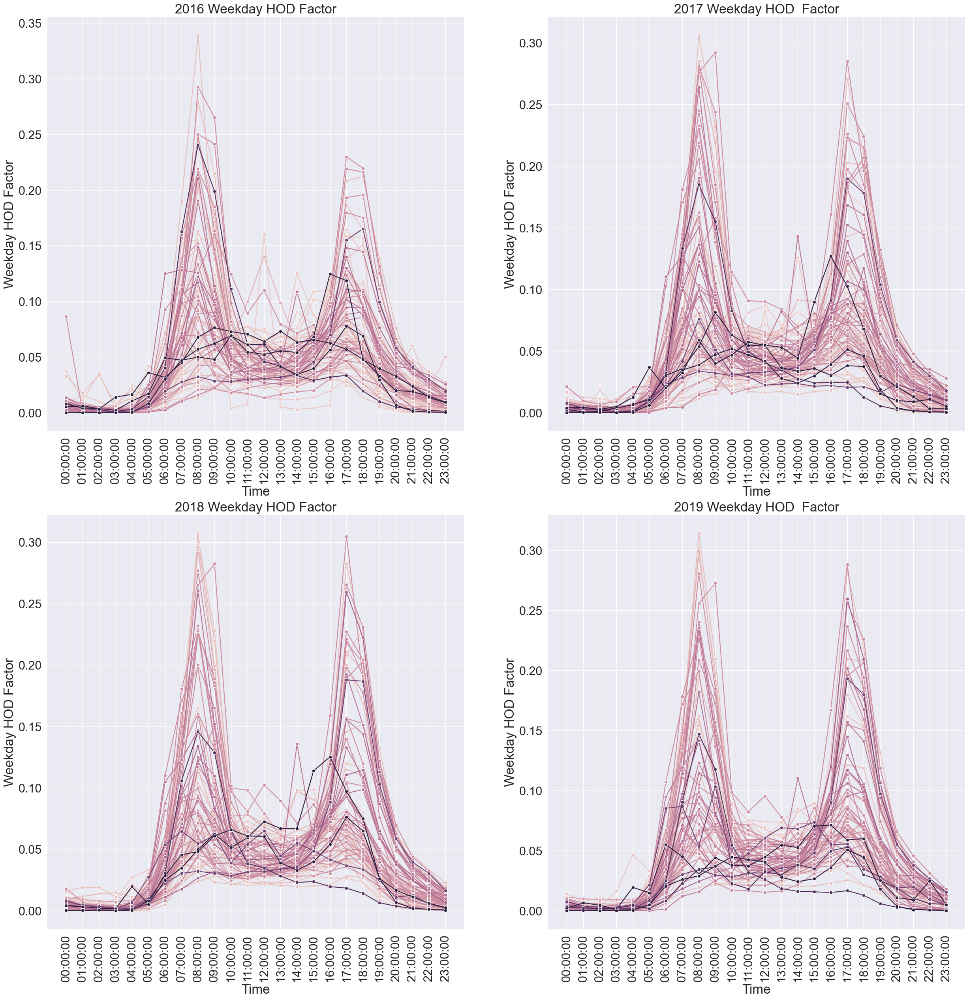

In [192]:
multiplot4(mid_s1)

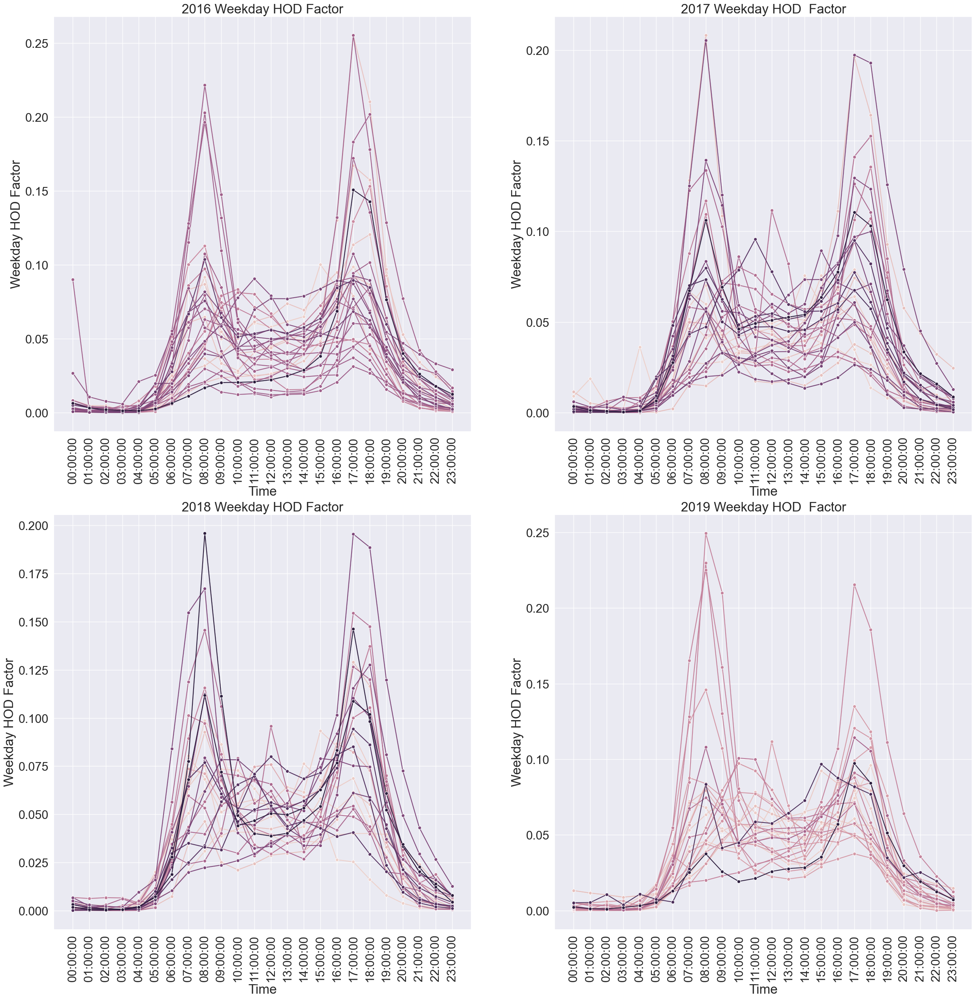

In [193]:
multiplot4(mid_s2)

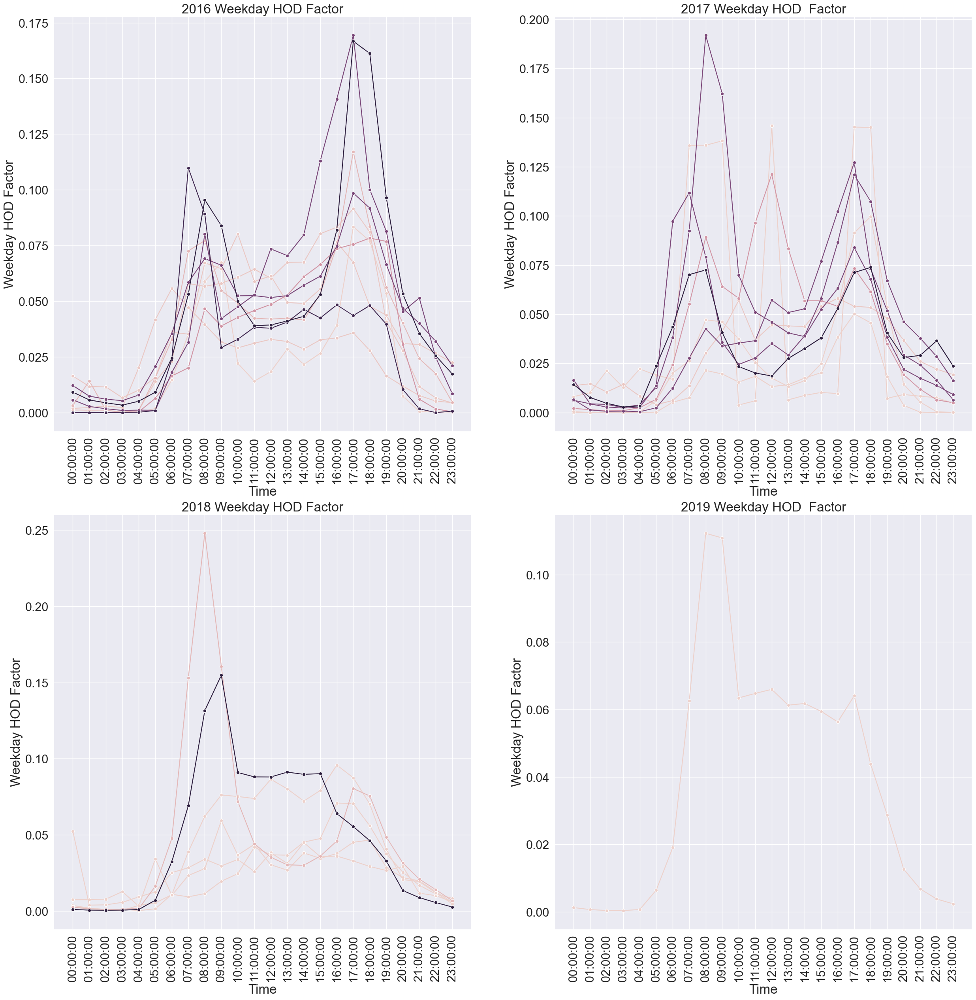

In [194]:
multiplot4(low_s1)

## Plot for Weekend Seasonal Factor Pattern

In [169]:
# join ind with weekend HOD factor
seasional_weekend=pd.merge(doh_weekend_factor,ind, left_on=['ID','year'], right_on=['ID','year'], how='inner')
seasional_weekend.shape

(51816, 49)

In [182]:
# define plot function
def multiplot4_weekend(seasional_weekend):
    d16=seasional_weekend.loc[seasional_weekend['year']==2016]
    d17=seasional_weekend.loc[seasional_weekend['year']==2017]
    d18=seasional_weekend.loc[seasional_weekend['year']==2018]
    d19=seasional_weekend.loc[seasional_weekend['year']==2019]
    import seaborn as sns

    sns.set(rc={'figure.figsize':(30,30)})
    sns.set(font_scale=2.0)
   


    fig, ax = plt.subplots(2,2)

    ax1 = sns.lineplot(x=d16['starttime'],y=d16['Average_HOD_Factor'],hue=d16['ID'],
                       markers=True,marker="o", dashes=False,sort=True,ax=ax[0,0]) 
    plt.xticks(rotation = 'vertical')
    ax2 = sns.lineplot(x=d17['starttime'],y=d17['Average_HOD_Factor'],hue=d17['ID'],
                       markers=True,marker="o", dashes=False,sort=True,ax=ax[0,1]) 
    plt.xticks(rotation = 'vertical')
    ax3 = sns.lineplot(x=d18['starttime'],y=d18['Average_HOD_Factor'],hue=d18['ID'],
                       markers=True,marker="o", dashes=False,sort=True,ax=ax[1,0])
    plt.xticks(rotation = 'vertical')
    ax4 = sns.lineplot(x=d19['starttime'],y=d19['Average_HOD_Factor'],hue=d19['ID'],
                       markers=True, marker="o", dashes=False,sort=True,ax=ax[1,1]) 
    plt.xticks(rotation = 'vertical')
    ax1.get_legend().remove()
    ax2.get_legend().remove()
    ax3.get_legend().remove()
    ax4.get_legend().remove()
    ax1.title.set_text('2016 Weekend HOD Factor')
    ax2.title.set_text('2017 Weekend HOD  Factor')
    ax3.title.set_text('2018 Weekend HOD Factor')
    ax4.title.set_text('2019 Weekend HOD  Factor')
    plt.setp(ax1.xaxis.get_majorticklabels(), rotation=90)
    plt.setp(ax2.xaxis.get_majorticklabels(), rotation=90)
    plt.setp(ax3.xaxis.get_majorticklabels(), rotation=90)
    plt.setp(ax4.xaxis.get_majorticklabels(), rotation=90)
    ax1.set_ylabel('Weekend HOD Factor' )
    ax1.set_xlabel('Time')
    ax2.set_ylabel('Weekend HOD Factor' )
    ax2.set_xlabel('Time')
    ax3.set_ylabel('Weekend HOD Factor' )
    ax3.set_xlabel('Time')
    ax4.set_ylabel('Weekend HOD Factor' )
    ax4.set_xlabel('Time')
    plt.show()


In [183]:
# classify the seasonality for weekend
high_s1w=seasional_weekend.loc[seasional_weekend['seasonal_factor']>2.0]
mid_s1w1 = seasional_weekend[(seasional_weekend.seasonal_factor>1) & (seasional_weekend.seasonal_factor<=1.5)]
mid_s1w2 = seasional_weekend[(seasional_weekend.seasonal_factor>1.5) & (seasional_weekend.seasonal_factor<=2)]
low_s1w = seasional_weekend.loc[seasional_weekend['seasonal_factor']<=1.0]
high_s1w.shape,mid_s1w.shape,low_s1w.shape

((4728, 49), (40080, 49), (2064, 49))

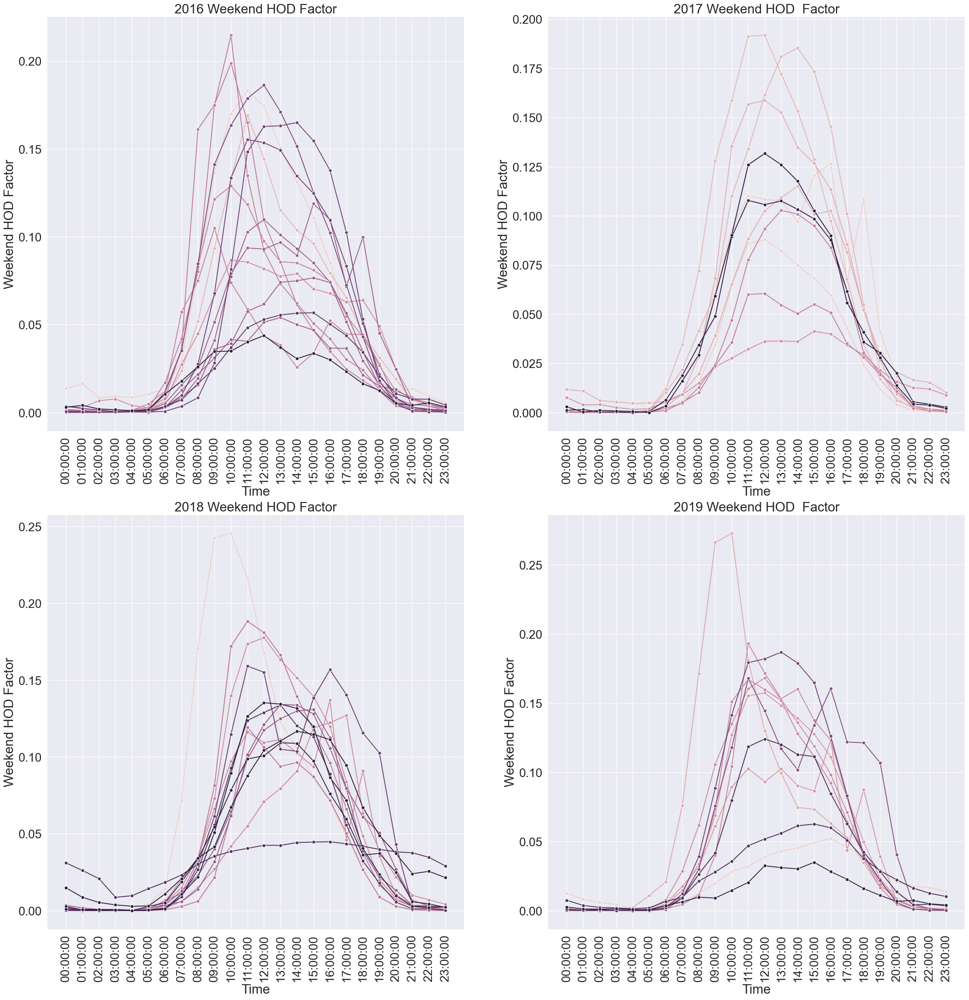

In [184]:
multiplot4_weekend(high_s1w)

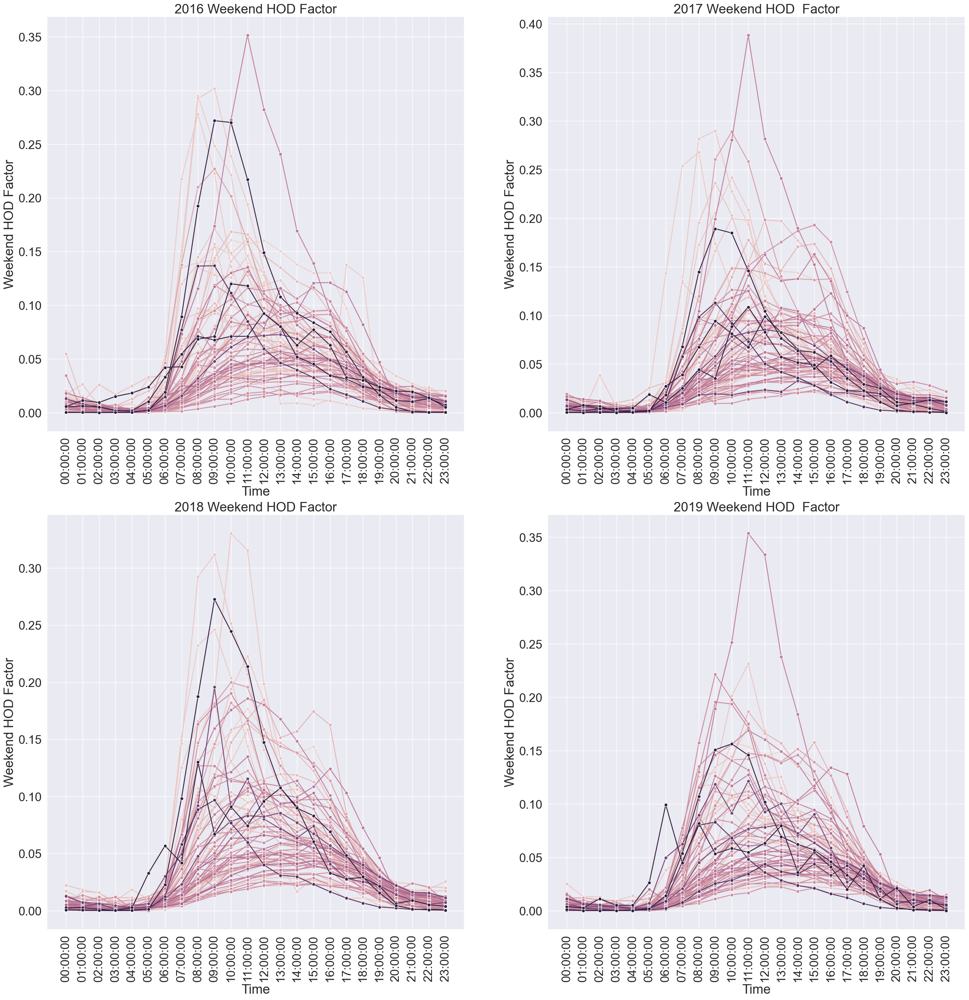

In [185]:
multiplot4_weekend(mid_s1w1)

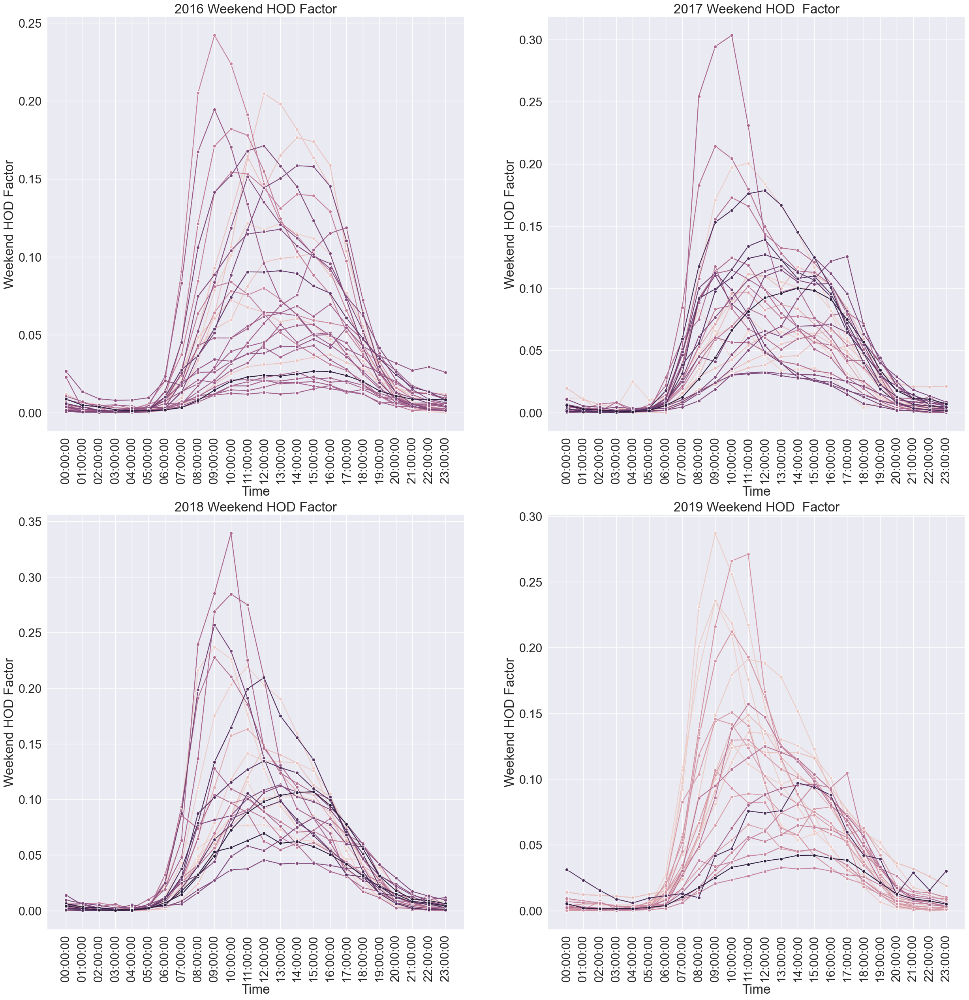

In [186]:
multiplot4_weekend(mid_s1w2)

In [187]:
mid_s1w2['ID'].nunique()

62

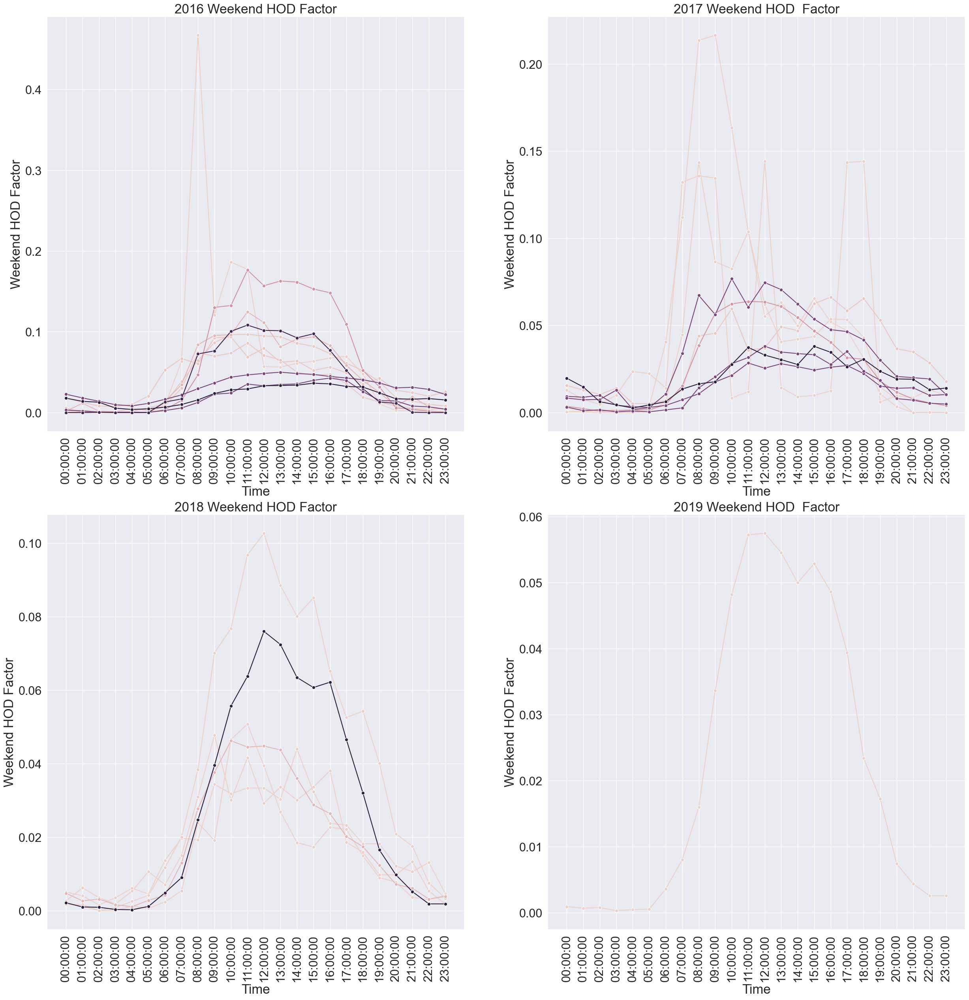

In [188]:
multiplot4_weekend(low_s1w)